In [71]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import numpy as np
import os
import random
import torchvision.transforms as T
from glob import glob
from tqdm import tqdm

In [72]:
folder = "/rds/general/user/mb1024/home/Friday"
npy_files = sorted(glob(os.path.join(folder, "*.npy")))

# Load arrays
sigma0_arrays = []
for f in npy_files:
    try:
        arr = np.load(f)
        sigma0_arrays.append(arr)
    except Exception as e:
        print(f"⚠️ Skipping {f}: {e}")

⚠️ Skipping /rds/general/user/mb1024/home/Friday/S1A_WV_SLC__1SSV_20241013T092735_20241013T093512_056082_06DC83_8F3D-WV_003___samp_100.npy: No data left in file
⚠️ Skipping /rds/general/user/mb1024/home/Friday/S1A_WV_SLC__1SSV_20241020T091828_20241020T092732_056184_06E08A_0A7B-WV_032___samp_100.npy: No data left in file
⚠️ Skipping /rds/general/user/mb1024/home/Friday/S1A_WV_SLC__1SSV_20241021T095957_20241021T100537_056199_06E12C_7164-WV_006___samp_100.npy: No data left in file


In [73]:
class InMemoryDinoDataset(Dataset):
    def __init__(self, array_stack, transform=None):
        self.data = array_stack
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        arr = self.data[idx].astype(np.float32)
        if np.std(arr) == 0:
            arr += np.random.normal(0, 1e-6, size=arr.shape)

        arr_norm = (arr - arr.min()) / (arr.max() - arr.min() + 1e-8)
        arr_norm = np.expand_dims(arr_norm, axis=0)
        img = torch.from_numpy(arr_norm)

        # also store the original, untransformed normalized version
        original = img.clone()

        if self.transform:
            crops = self.transform(img)
            return crops, original  # return both
        else:
            return [img], original


In [74]:
class DinoMultiCropTransform:
    def __init__(self):
        # 2 global crops: random resized crop, larger area
        self.global_transform = T.Compose([
            T.RandomResizedCrop((204, 204), scale=(0.4, 1.0)),
            T.RandomHorizontalFlip(),
            T.RandomApply([T.RandomErasing(p=1.0, scale=(0.02, 0.15))], p=0.7)
        ])

        # 6 local crops: smaller crops
        self.local_transform = T.Compose([
            T.RandomResizedCrop((96, 96), scale=(0.05, 0.4)),
            T.RandomHorizontalFlip(),
            T.RandomApply([T.RandomErasing(p=1.0, scale=(0.02, 0.15))], p=0.5)
        ])

    def __call__(self, x):
        crops = []
        # 2 global
        for _ in range(2):
            crops.append(self.global_transform(x))
        # 6 local
        for _ in range(6):
            crops.append(self.local_transform(x))
        return crops

In [10]:
data = np.load("/rds/general/user/mb1024/home/sigma0_arrays/sigma0_all.npz")
sigma0_arrays = [data[key] for key in data.files]

In [12]:
folder = "/rds/general/user/mb1024/home/SA"
npy_files = sorted(glob(os.path.join(folder, "*.npy")))

# Load arrays
SA_arrays = []
for f in npy_files:
    try:
        arr = np.load(f)
        SA_arrays.append(arr)
    except Exception as e:
        print(f"⚠️ Skipping {f}: {e}")

⚠️ Skipping /rds/general/user/mb1024/home/SA/S1A_WV_SLC__1SSV_20250310T211043_20250310T211918_058247_0732DA_AB0D-WV_015___samp_100.npy: No data left in file
⚠️ Skipping /rds/general/user/mb1024/home/SA/S1A_WV_SLC__1SSV_20250506T190718_20250506T192412_059077_075440_C698-WV_025___samp_100.npy: No data left in file


In [13]:
sigma0_arrays = sigma0_arrays + SA_arrays

In [14]:
print(len(sigma0_arrays))

25013


In [5]:
# we can assign keys like sigma0_0, sigma0_1, etc
save_dict = {f'sigma0_{i}': arr for i, arr in enumerate(sigma0_arrays)}

np.savez("/rds/general/user/mb1024/home/sigma0_arrays/sigma0_all_combined.npz", **save_dict)

NameError: name 'sigma0_arrays' is not defined

In [ ]:
data = np.load("/rds/general/user/mb1024/home/sigma0_arrays/sigma0_all_combined.npz")
sigma0_arrays = [data[key] for key in data.files]

In [153]:
print(len(sigma0_arrays))


1195


In [75]:
import numpy as np
from scipy import ndimage

def nearest_neighbor_fill(arr):
    nan_mask = np.isnan(arr)
    
    # indices of valid (non-NaN) points
    valid_mask = ~nan_mask
    
    if np.all(nan_mask):
        # entire image is NaN — fallback
        return np.zeros_like(arr)
    
    # coordinates of all pixels
    coords = np.array(np.nonzero(valid_mask)).T
    # coordinates of nan pixels
    nan_coords = np.array(np.nonzero(nan_mask)).T
    
    # build a KDTree on valid points
    from scipy.spatial import cKDTree
    tree = cKDTree(coords)
    
    # query nearest neighbor for each NaN coordinate
    nearest_indices = tree.query(nan_coords, k=1)[1]
    nearest_values = arr[tuple(coords[nearest_indices].T)]
    
    # fill NaNs with nearest values
    filled_arr = arr.copy()
    filled_arr[tuple(nan_coords.T)] = nearest_values
    
    return filled_arr

In [76]:
def pad_to_max_with_mean(arr, target_height=204, target_width=214):
    h, w = arr.shape
    pad_value = np.mean(arr)
    
    padded = np.full((target_height, target_width), pad_value, dtype=arr.dtype)
    
    # compute offset to center the image
    y_offset = (target_height - h) // 2
    x_offset = (target_width - w) // 2
    
    padded[y_offset:y_offset + h, x_offset:x_offset + w] = arr
    
    return padded

In [77]:
clean_sigma0_arrays = [nearest_neighbor_fill(arr) for arr in sigma0_arrays]

In [78]:
cropped_arrays = [pad_to_max_with_mean(arr) for arr in clean_sigma0_arrays]


In [79]:
min_height = min(arr.shape[0] for arr in cropped_arrays)
min_width = min(arr.shape[1] for arr in cropped_arrays)

In [80]:
sigma0 = [
    arr[:min_height, :min_width]
    for arr in sigma0_stack
]

In [81]:
sigma0_stack = np.stack(sigma0)

In [33]:
print(sigma0_stack.shape)

(1195, 204, 214)


In [ ]:
import torch.nn as nn
import torch.nn as nn

class simple_cnn(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.c1 = nn.Conv2d(1, 32, kernel_size=3, stride=1, padding=1)
        self.b1 = nn.BatchNorm2d(32)
        
        self.c2 = nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1)
        self.b2 = nn.BatchNorm2d(64)
        
        self.c3 = nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1)
        self.b3 = nn.BatchNorm2d(128)
        
        self.c4 = nn.Conv2d(128, 256, kernel_size=3, stride=1, padding=1)
        self.b4 = nn.BatchNorm2d(256)
        
        self.c5 = nn.Conv2d(256, 512, kernel_size=3, stride=1, padding=1)
        self.b5 = nn.BatchNorm2d(512)
        
        self.c6 = nn.Conv2d(512, 512, kernel_size=3, stride=1, padding=1)
        self.b6 = nn.BatchNorm2d(512)
        
        self.act = nn.ReLU()
        self.p = nn.MaxPool2d(kernel_size=2, stride=2)
        self.avg = nn.AdaptiveAvgPool2d((1, 1))
        # smaller projection head output
        self.projection_head = nn.Linear(512, 128)

    def forward(self, x):
        x = self.p(self.act(self.b1(self.c1(x))))
        x = self.p(self.act(self.b2(self.c2(x))))
        x = self.p(self.act(self.b3(self.c3(x))))
        x = self.p(self.act(self.b4(self.c4(x))))
        x = self.p(self.act(self.b5(self.c5(x))))
        x = self.p(self.act(self.b6(self.c6(x))))  # add dropout after last conv
        x = self.avg(x)
        x = x.view(x.size(0), -1)
        x = self.projection_head(x)
        return x

In [ ]:
data = np.load("sigma0_processed.npz")
sigma0_stack = [data[key] for key in data.files]

In [ ]:
sigma0_stack = np.stack(sigma0_stack)

In [125]:
sigma0_stack.shape

(28344, 204, 216)

In [124]:
sigma0_stack = sigma0_stack.squeeze(0)

In [126]:
multi_crop_transform = DinoMultiCropTransform()
train_dataset = InMemoryDinoDataset(sigma0_stack, transform=multi_crop_transform)

In [127]:
print(len(train_dataset))

28344


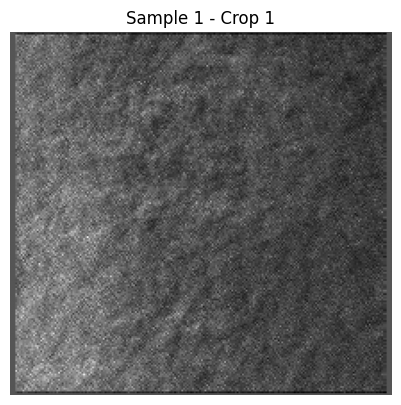

In [20]:
import random
import matplotlib.pyplot as plt

random_idx = random.randint(0, len(train_dataset[0]) - 1)
crops = train_dataset[0][random_idx]

plt.figure(figsize=(16, 8))
for i, crop in enumerate(crops):
    img = crop.squeeze().numpy()
    plt.subplot(2, 4, i+1)
    plt.imshow(img, cmap="gray")
    plt.title(f"Sample {random_idx} - Crop {i+1}")
    plt.axis("off")
plt.tight_layout()
plt.show()

In [128]:
class DinoLoss(nn.Module):
    def __init__(self, out_dim=128, student_temp=0.1, teacher_temp=0.04, center_momentum=0.9):
        super().__init__()
        self.student_temp = student_temp
        self.teacher_temp = teacher_temp
        self.center_momentum = center_momentum
        self.register_buffer("center", torch.zeros(1, out_dim))

    def forward(self, student_outputs, teacher_outputs):
        # get center aligned
        center = self.center.to(teacher_outputs[0].device)
        student_logits = [s / self.student_temp for s in student_outputs]
        teacher_probs = [
            F.softmax((t - center) / self.teacher_temp, dim=-1).detach()
            for t in teacher_outputs
        ]

        total_loss = 0.0
        n_loss_terms = 0

        for iq, teacher_out in enumerate(teacher_probs):
            for v, student_out in enumerate(student_logits):
                if v == iq:
                    continue
                loss = -torch.sum(teacher_out * F.log_softmax(student_out, dim=-1), dim=-1)
                total_loss += loss.mean()
                n_loss_terms += 1

        total_loss /= n_loss_terms

        # update center (with device match)
        batch_center = torch.cat(teacher_outputs, dim=0).mean(dim=0, keepdim=True)
        self.center = self.center.to(batch_center.device)
        self.center.mul_(self.center_momentum).add_(batch_center * (1 - self.center_momentum))

        return total_loss


In [129]:
def dino_collate_fn(batch):
    """
    Collate multi-crops:
    - batch: list of (crops, original) pairs
    - returns:
        stacked_views: list of [B, C, H, W] tensors
        originals:     tensor [B, C, H, W]
    """
    crops_list = [item[0] for item in batch]
    originals   = [item[1] for item in batch]

    num_views = len(crops_list[0])
    stacked_views = []

    for i in range(num_views):
        stacked = torch.stack([crops[i] for crops in crops_list], dim=0)
        stacked_views.append(stacked)

    stacked_originals = torch.stack(originals, dim=0)

    return stacked_views, stacked_originals

In [141]:
transform = DinoMultiCropTransform()
dataset = InMemoryDinoDataset(sigma0_stack, transform)
dataloader = DataLoader(dataset, batch_size=32, shuffle=True, num_workers=4, pin_memory=True, collate_fn=dino_collate_fn)

student = simple_cnn()
teacher = simple_cnn()
teacher.load_state_dict(student.state_dict())
for p in teacher.parameters():
    p.requires_grad = False

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
student.to(device)
teacher.to(device)

optimizer = torch.optim.Adam(student.parameters(), lr=0.001)
loss_fn = DinoLoss(out_dim=128)

teacher_momentum = 0.996

In [142]:
@torch.no_grad()
def update_teacher(student, teacher, momentum=0.996):
    """
    Update the teacher model with an EMA of the student parameters.
    """
    for param_s, param_t in zip(student.parameters(), teacher.parameters()):
        param_t.data.mul_(momentum).add_(param_s.data * (1.0 - momentum))

In [143]:
num_epochs = 20

for epoch in range(num_epochs):
    student.train()
    teacher.eval()
    total_loss = 0.0

    for crops, originals in tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        # move to device
        crops = [c.to(device) for c in crops]
        originals = originals.to(device)

        # forward pass through student
        student_outputs = [student(c) for c in crops]

        # forward pass through teacher (on first two crops, typically global)
        with torch.no_grad():
            teacher_outputs = [teacher(c) for c in crops[:2]]

        # compute DINO loss here (you would pass student_outputs, teacher_outputs)
        loss = loss_fn(student_outputs, teacher_outputs)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    avg_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch+1}/{num_epochs}, avg loss: {avg_loss:.4f}")

    # optionally update teacher
    update_teacher(student, teacher, momentum=0.996)


Epoch 1/20: 100%|██████████| 886/886 [01:44<00:00,  8.52it/s]


Epoch 1/20, avg loss: 5.0347


Epoch 2/20: 100%|██████████| 886/886 [01:44<00:00,  8.47it/s]


Epoch 2/20, avg loss: 4.8541


Epoch 3/20: 100%|██████████| 886/886 [01:44<00:00,  8.45it/s]


Epoch 3/20, avg loss: 4.8530


Epoch 4/20: 100%|██████████| 886/886 [01:44<00:00,  8.46it/s]


Epoch 4/20, avg loss: 4.8552


Epoch 5/20: 100%|██████████| 886/886 [01:44<00:00,  8.47it/s]


Epoch 5/20, avg loss: 4.8523


Epoch 6/20: 100%|██████████| 886/886 [01:44<00:00,  8.46it/s]


Epoch 6/20, avg loss: 4.8527


Epoch 7/20: 100%|██████████| 886/886 [01:44<00:00,  8.48it/s]


Epoch 7/20, avg loss: 4.8523


Epoch 8/20: 100%|██████████| 886/886 [01:44<00:00,  8.48it/s]


Epoch 8/20, avg loss: 4.8524


Epoch 9/20: 100%|██████████| 886/886 [01:48<00:00,  8.14it/s]


Epoch 9/20, avg loss: 4.8544


Epoch 10/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 10/20, avg loss: 4.8521


Epoch 11/20: 100%|██████████| 886/886 [01:44<00:00,  8.48it/s]


Epoch 11/20, avg loss: 4.8520


Epoch 12/20: 100%|██████████| 886/886 [01:44<00:00,  8.47it/s]


Epoch 12/20, avg loss: 4.8525


Epoch 13/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 13/20, avg loss: 4.8520


Epoch 14/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 14/20, avg loss: 4.8520


Epoch 15/20: 100%|██████████| 886/886 [01:44<00:00,  8.48it/s]


Epoch 15/20, avg loss: 4.8524


Epoch 16/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 16/20, avg loss: 4.8520


Epoch 17/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 17/20, avg loss: 4.8520


Epoch 18/20: 100%|██████████| 886/886 [01:44<00:00,  8.48it/s]


Epoch 18/20, avg loss: 4.8520


Epoch 19/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]


Epoch 19/20, avg loss: 4.8520


Epoch 20/20: 100%|██████████| 886/886 [01:44<00:00,  8.49it/s]

Epoch 20/20, avg loss: 4.8520


In [144]:
all_originals = []
all_features = []

student.eval()
with torch.no_grad():
    for crops, originals in dataloader:
        originals = originals.to(device)
        features = student(originals)  # get projection features for originals
        all_originals.append(originals.cpu())
        all_features.append(features.cpu())

# concatenate across all batches
all_originals = torch.cat(all_originals, dim=0)
all_features = torch.cat(all_features, dim=0)


In [145]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
# === CONFIG ===
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
num_clusters = 8  # Set this based on how many groups you expect

# === STEP 2: Dimensionality Reduction ===
def reduce_dimensionality(features, n_pca=50):
    features = features[~np.isnan(features).any(axis=1)]
    pca = PCA(n_components=n_pca)
    return pca.fit_transform(features)

In [146]:
from sklearn.preprocessing import normalize
from sklearn.cluster import KMeans

def cluster_features_cosine(features, num_clusters):
    # normalize features to unit vectors
    normed_features = normalize(features, norm="l2", axis=1)
    
    # KMeans will then behave as cosine-based clustering
    kmeans = KMeans(n_clusters=num_clusters, random_state=0)
    cluster_ids = kmeans.fit_predict(normed_features)
    
    return cluster_ids

# === STEP 4: Visualization with t-SNE ===
def visualize_clusters(features, cluster_ids, title="t-SNE Clustering"):
    tsne = TSNE(n_components=2, perplexity=30, random_state=0)
    embedded = tsne.fit_transform(features)
    plt.figure(figsize=(8, 6))
    plt.scatter(embedded[:, 0], embedded[:, 1], c=cluster_ids, cmap='tab10', s=5)
    plt.title(title)
    plt.colorbar()
    plt.show()

In [147]:
import hdbscan

def cluster_hdbscan(features, min_cluster_size=200):
    normed_features = normalize(features, norm="l2", axis=1)
    clusterer = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size)
    cluster_ids = clusterer.fit_predict(normed_features)
    return cluster_ids

from sklearn.mixture import GaussianMixture

def cluster_gmm(features, num_clusters):
    normed_features = normalize(features, norm="l2", axis=1)
    gmm = GaussianMixture(n_components=num_clusters, random_state=0)
    cluster_ids = gmm.fit_predict(normed_features)
    return cluster_ids

In [148]:
reduced_features =  reduce_dimensionality(all_features.numpy(), n_pca=50)

In [149]:
cluster_ids = cluster_features_cosine(reduced_features, num_clusters=num_clusters)

In [150]:
from collections import defaultdict


Running kmeans clustering...


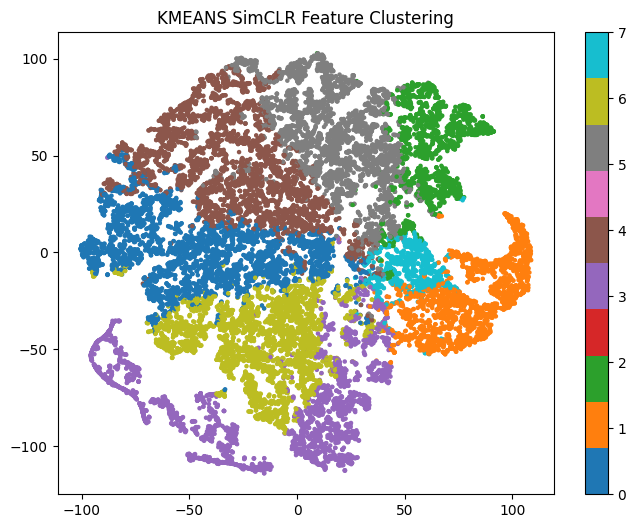

Showing sample images for kmeans clusters...


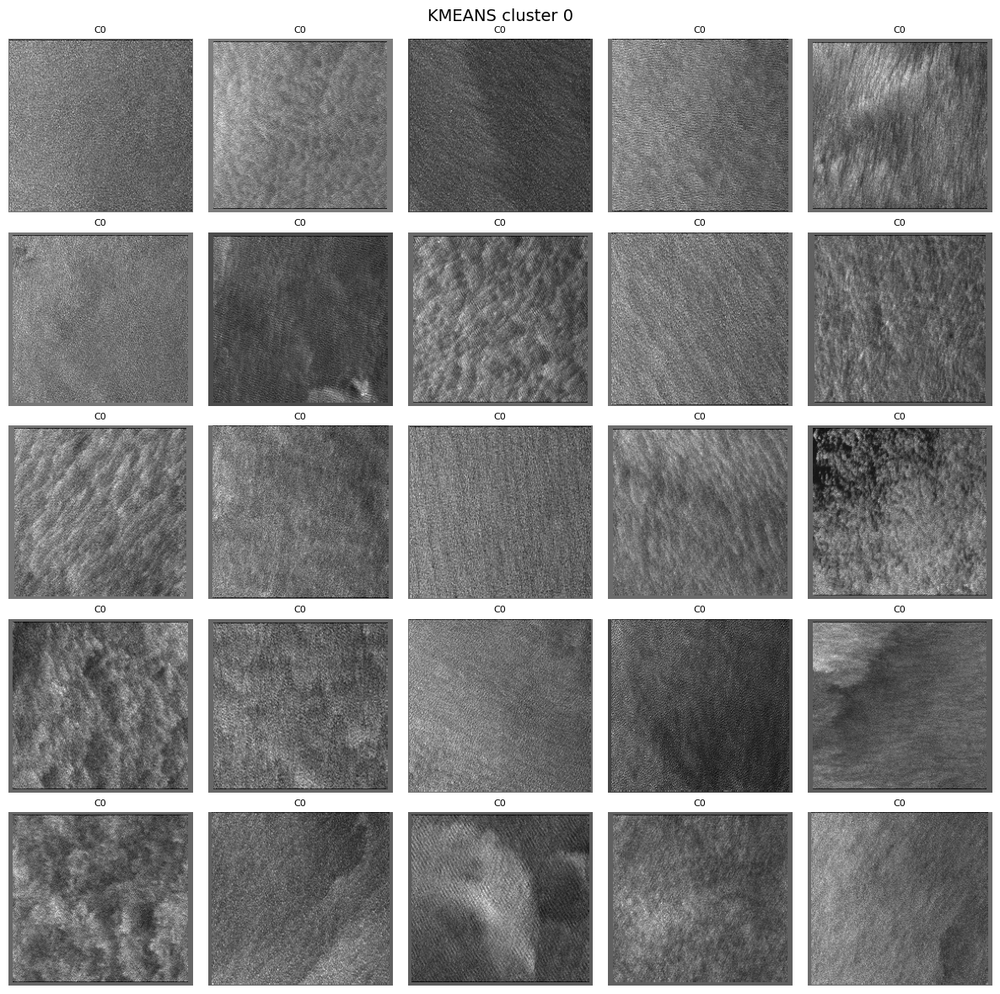

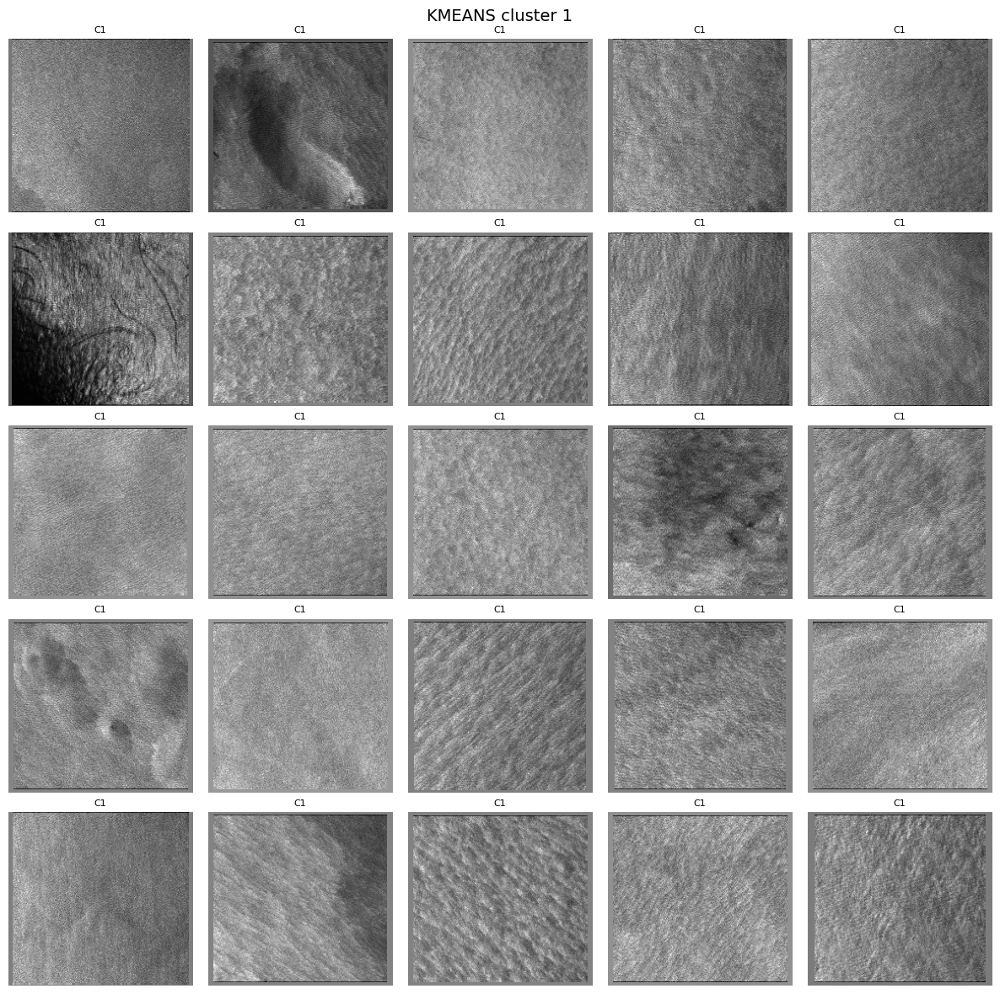

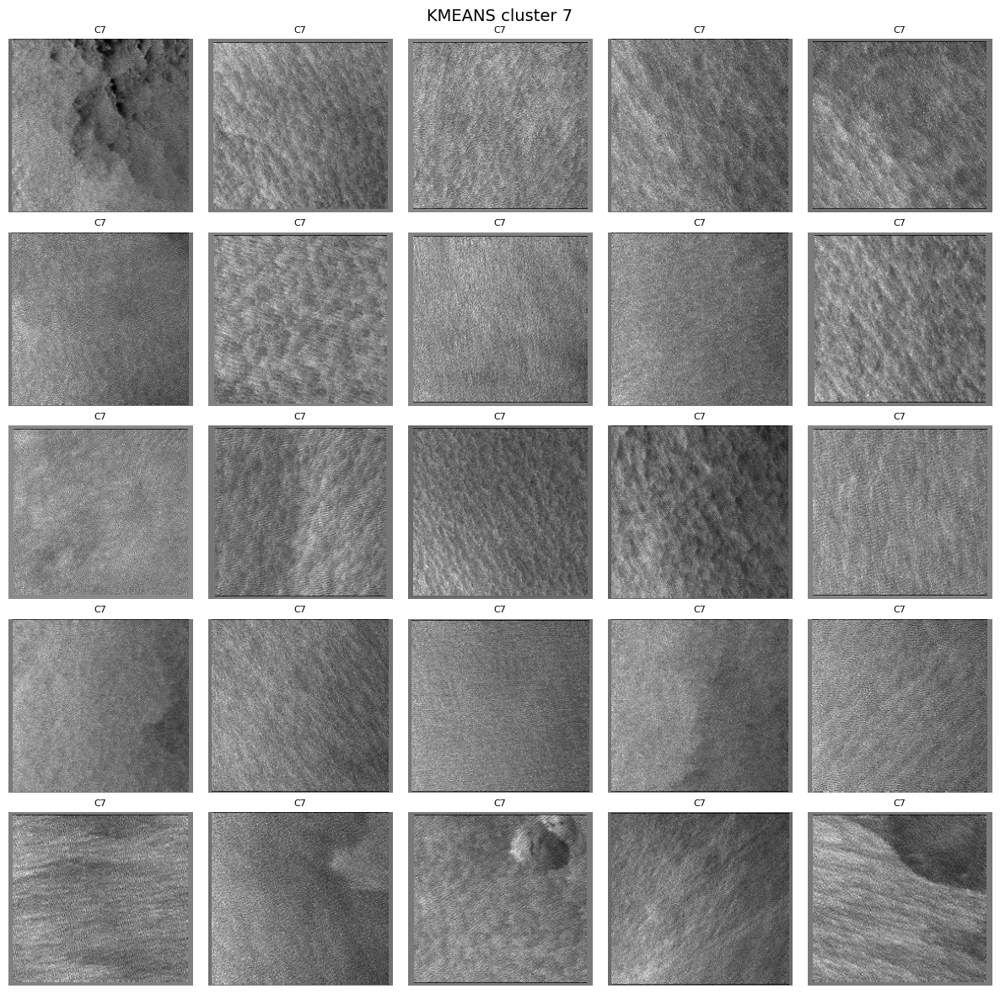

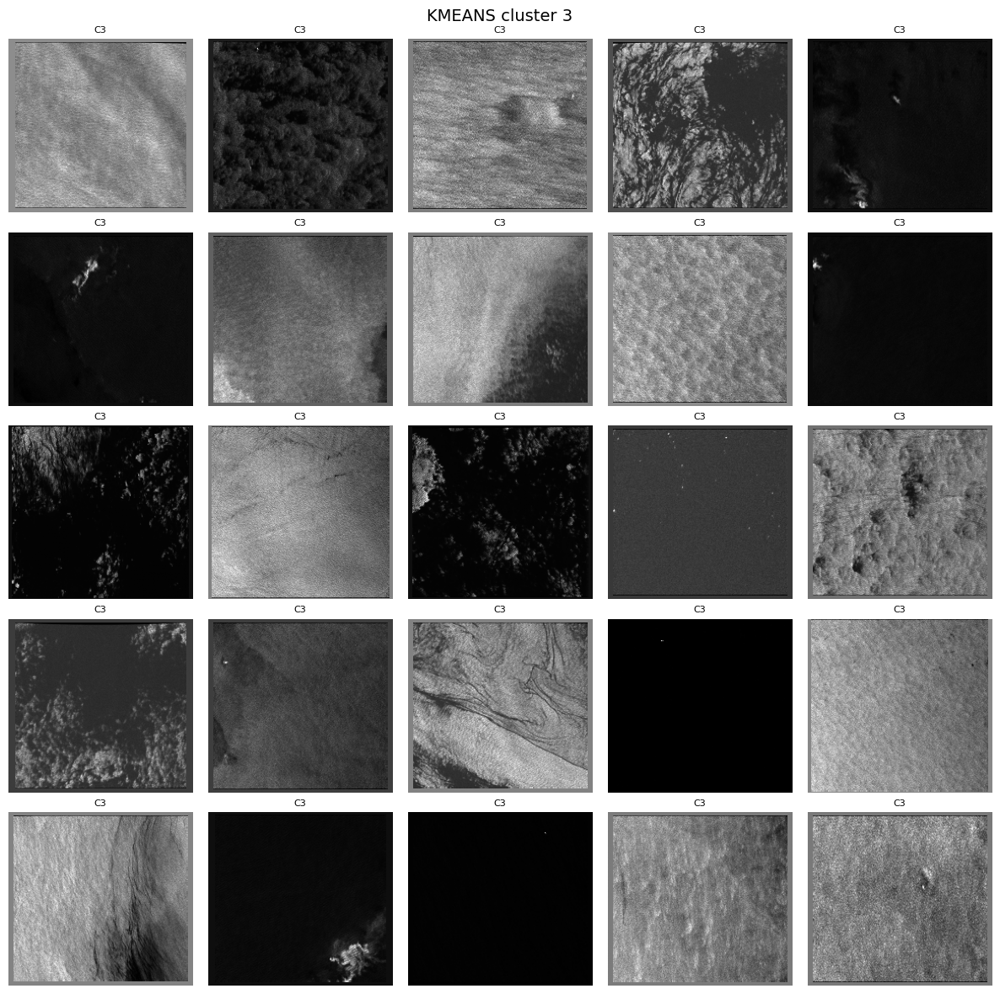

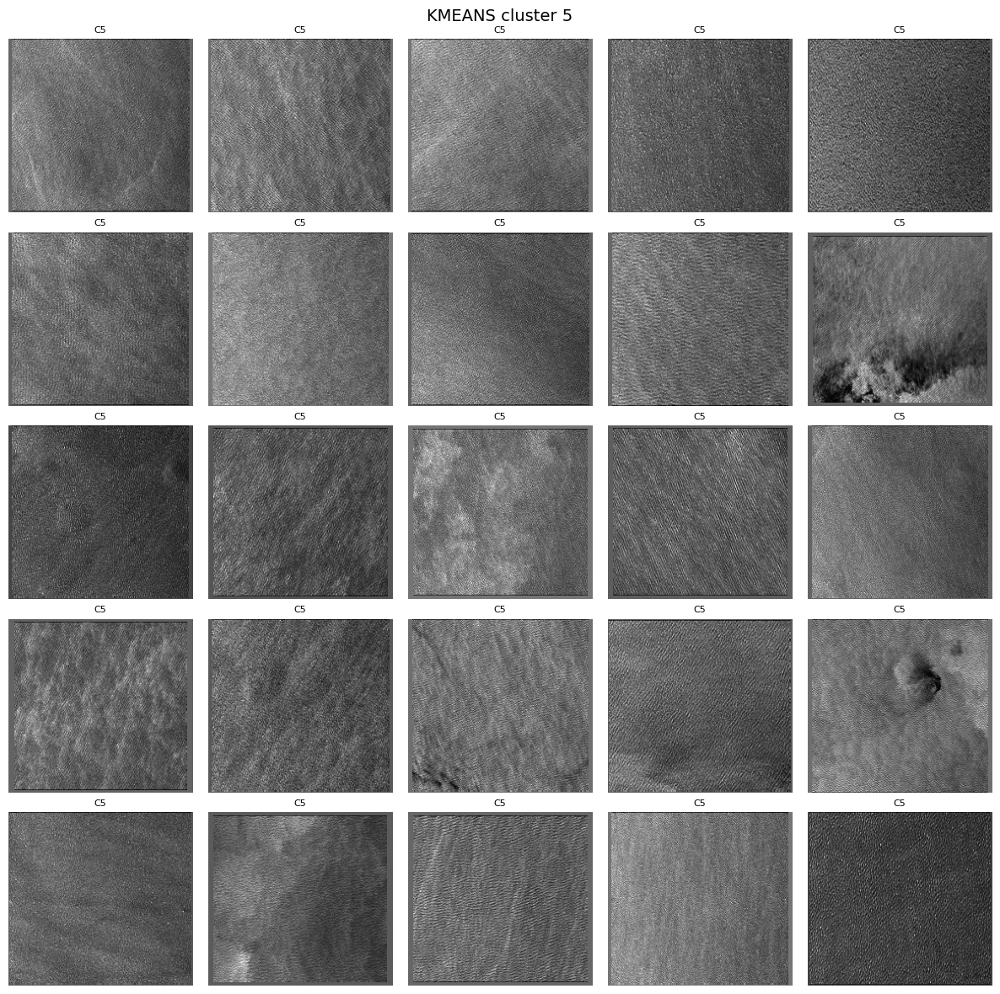

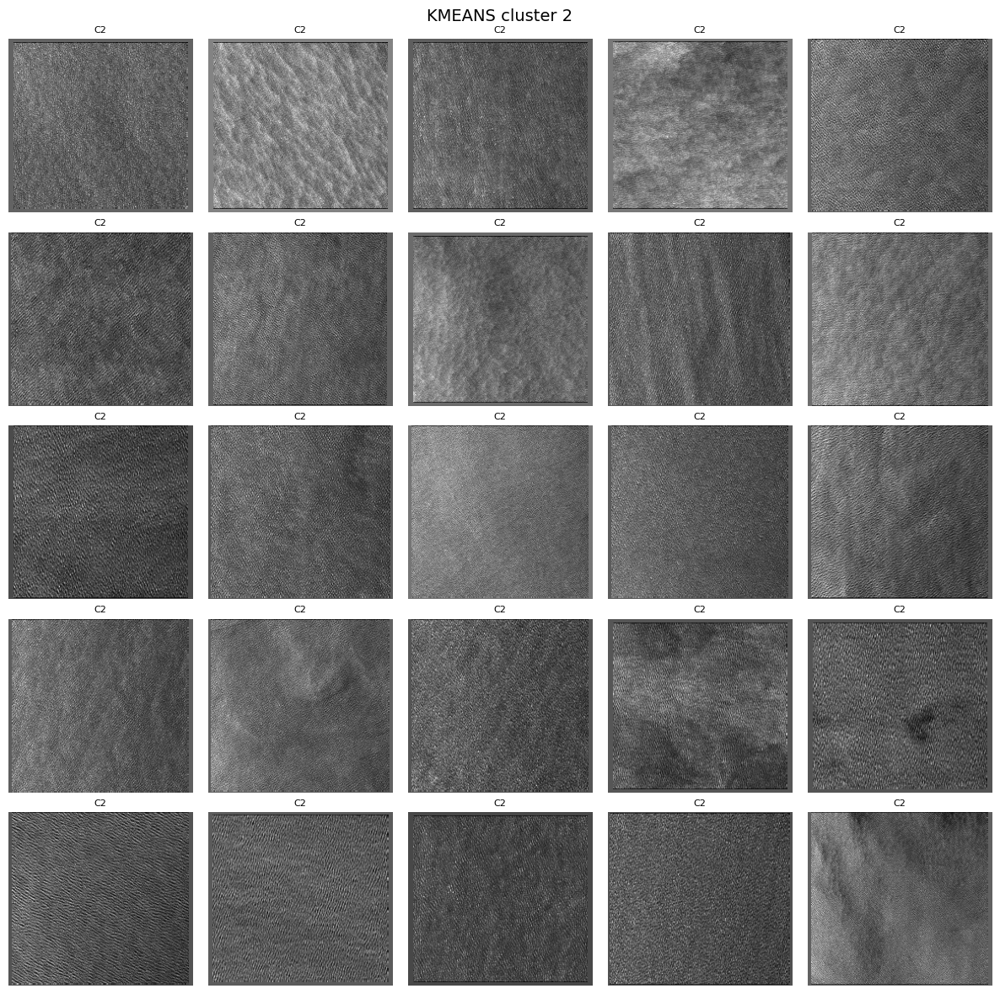

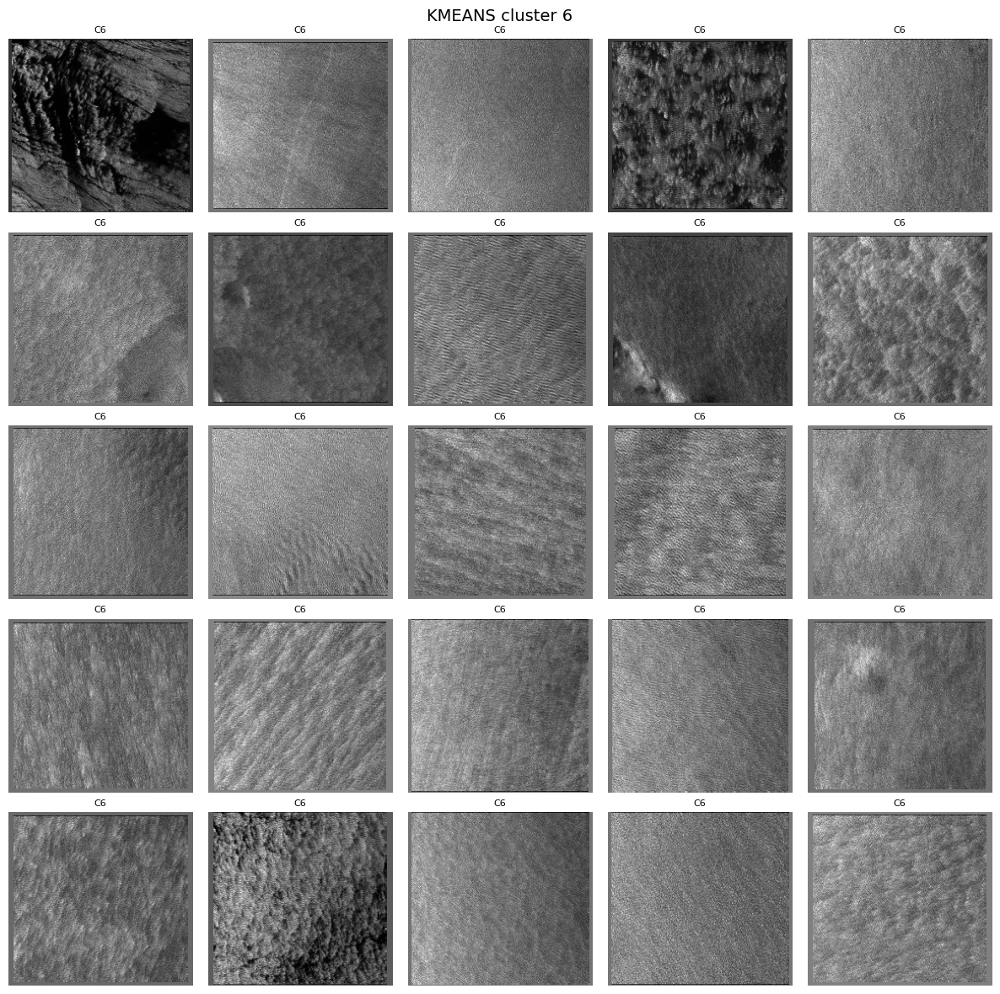

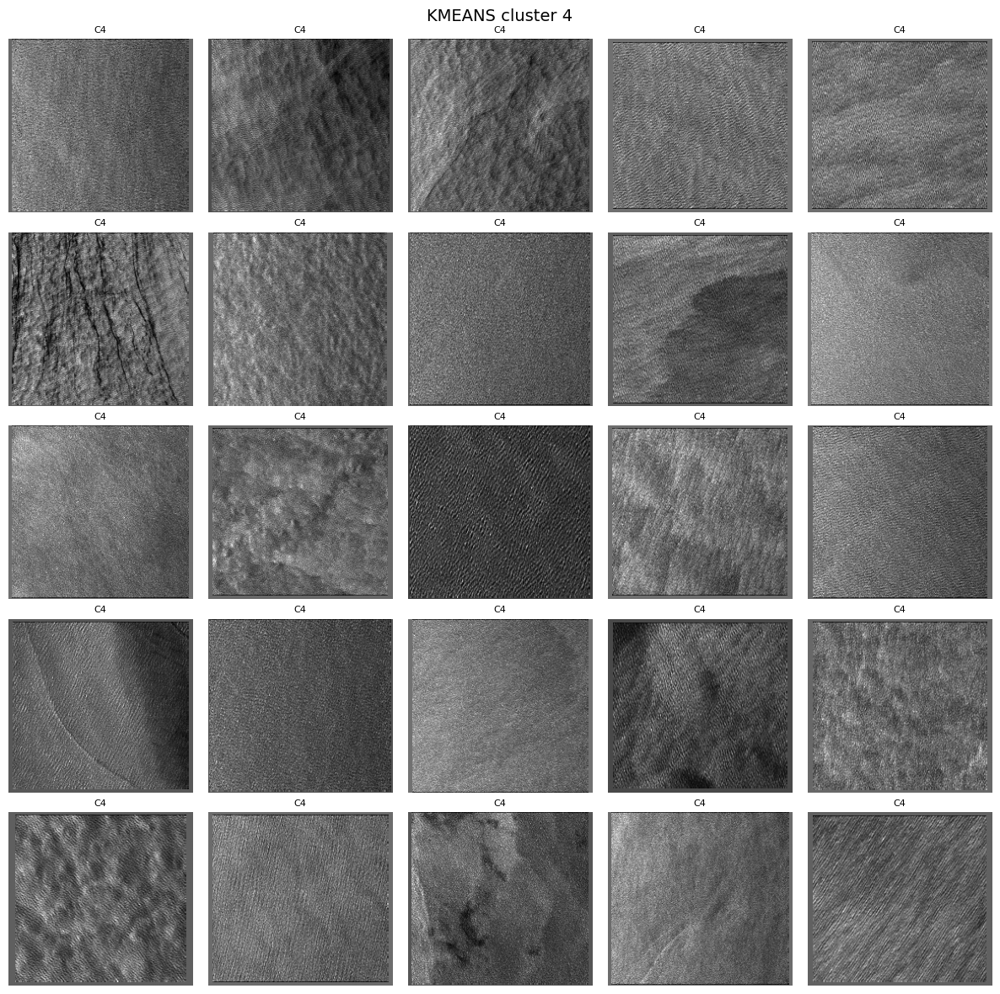

Running hdbscan clustering...


/rds/general/user/mb1024/home/myenv/lib64/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
/rds/general/user/mb1024/home/myenv/lib64/python3.11/site-packages/sklearn/utils/deprecation.py:132: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(


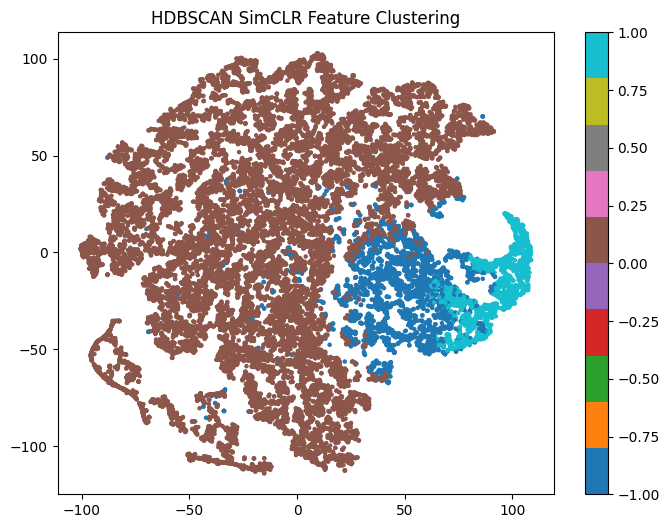

Showing sample images for hdbscan clusters...


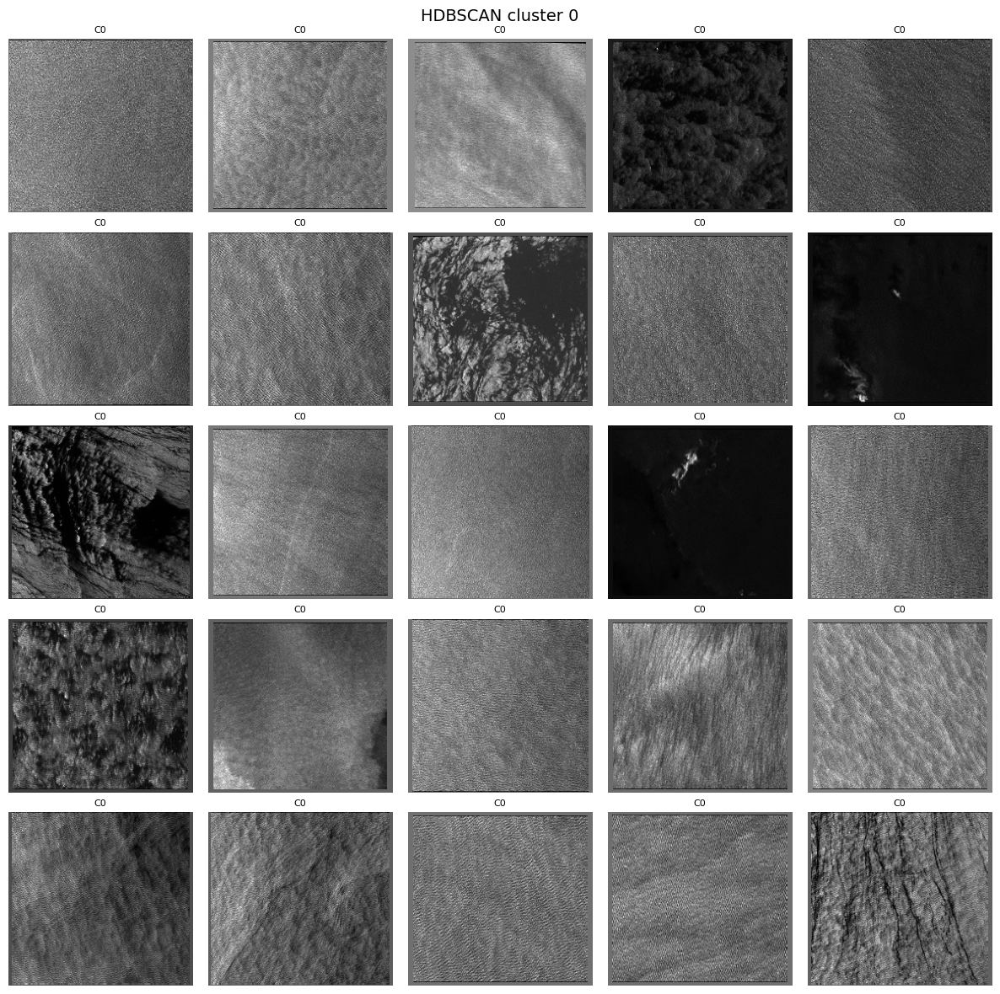

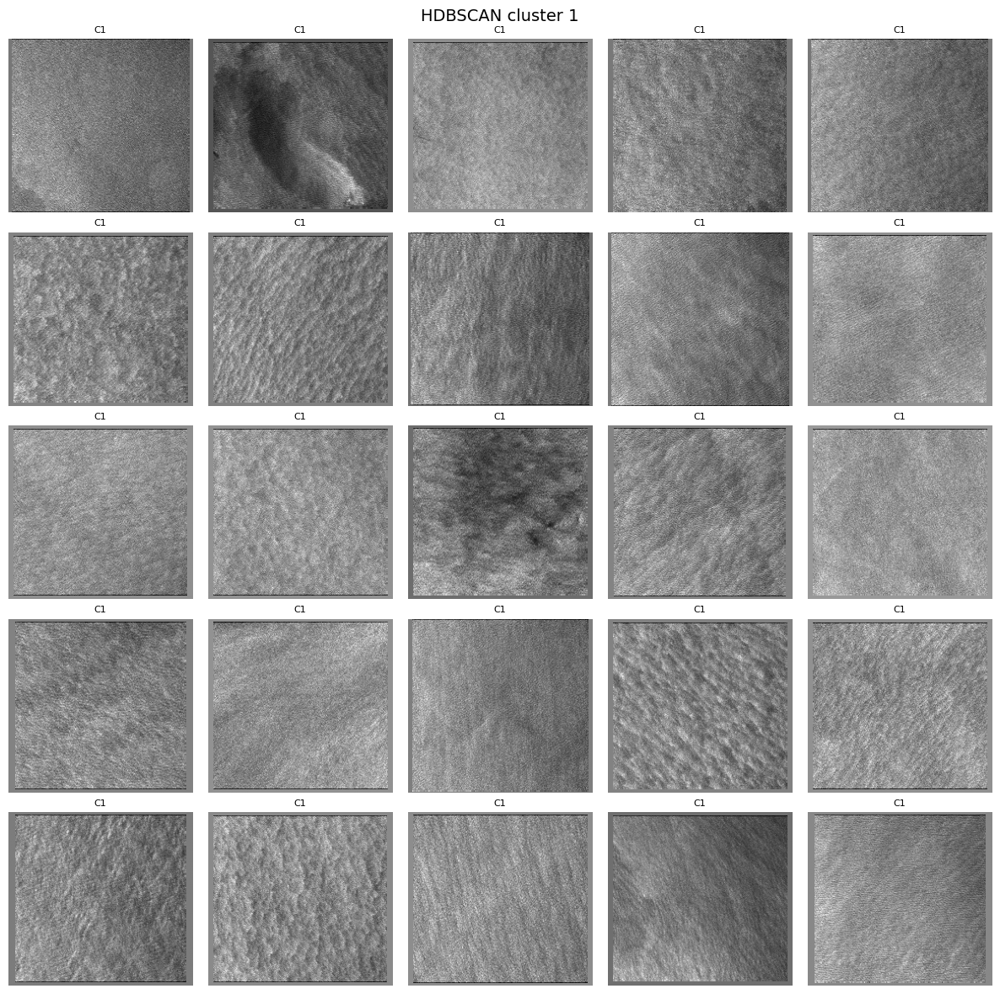

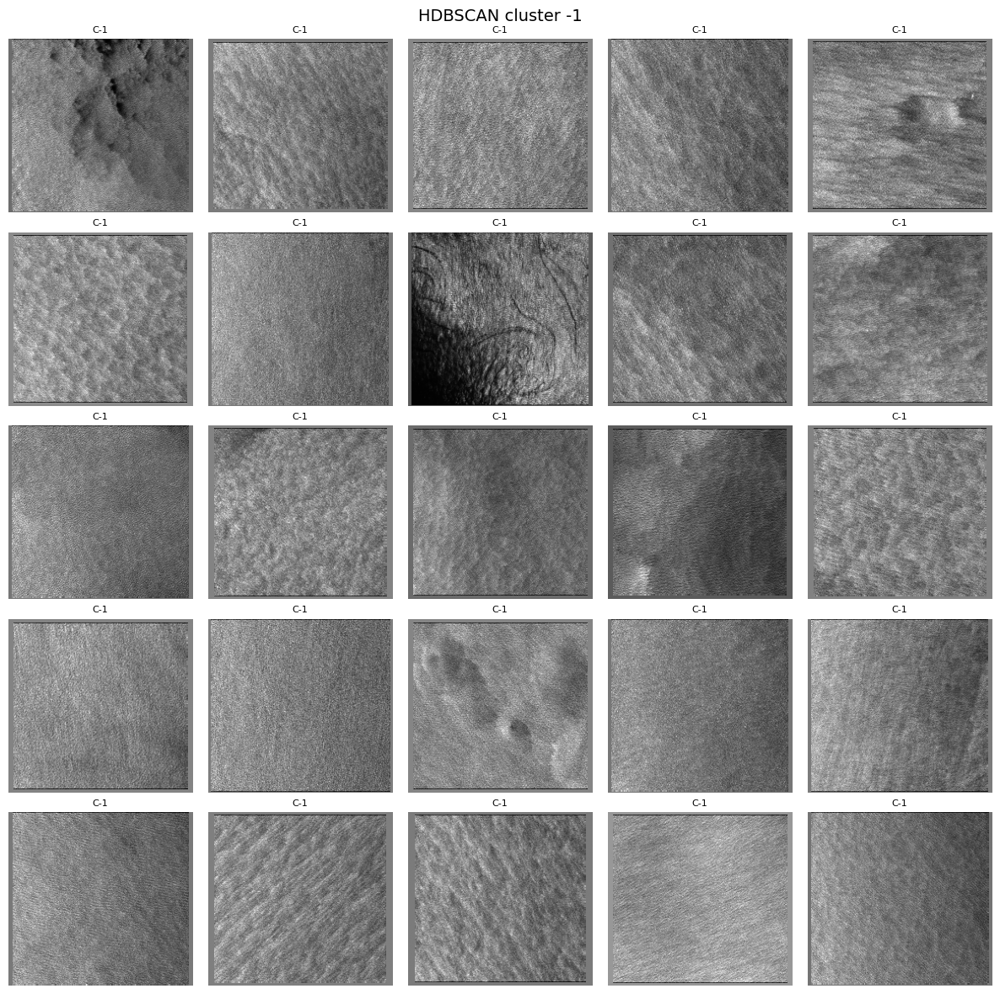

Running gmm clustering...


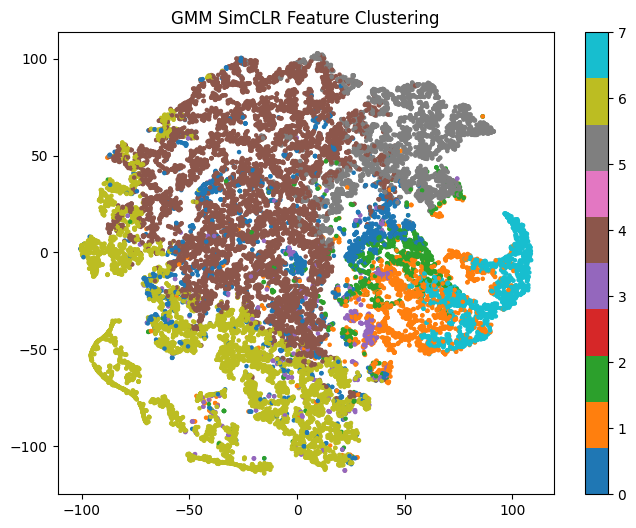

Showing sample images for gmm clusters...


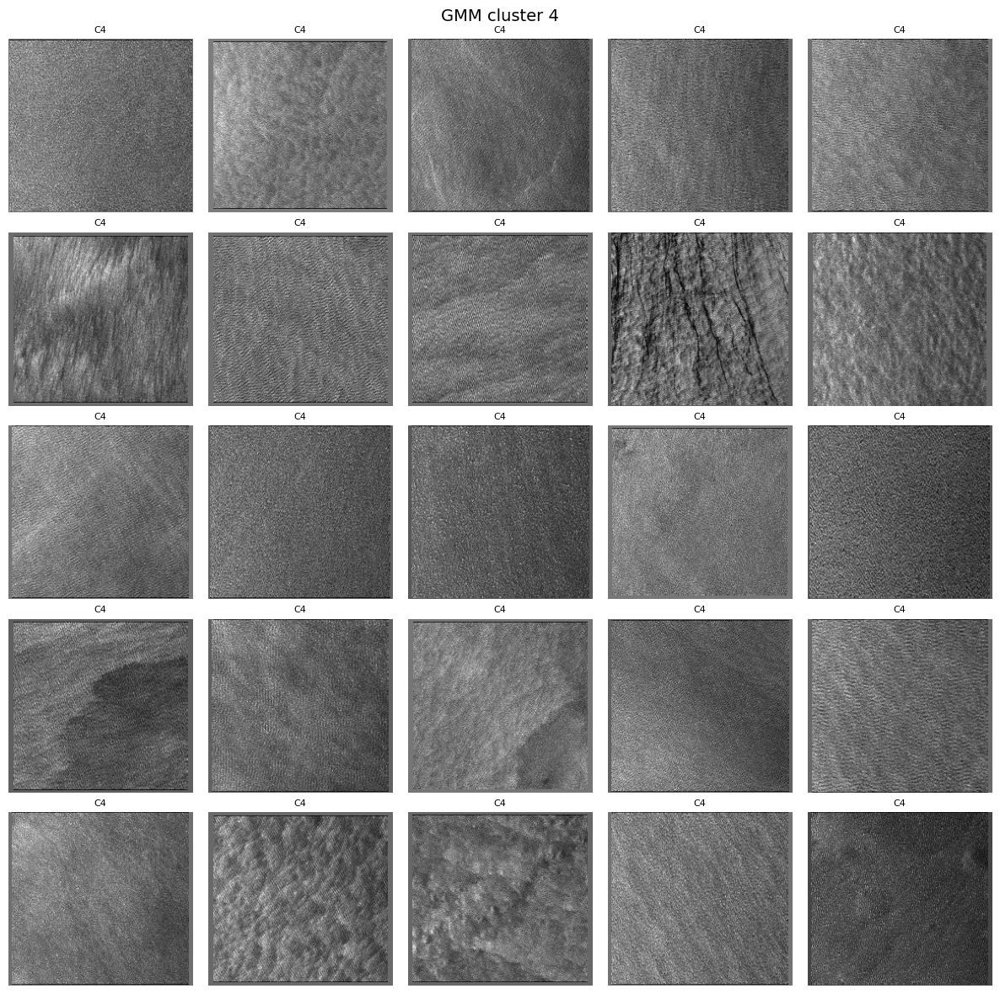

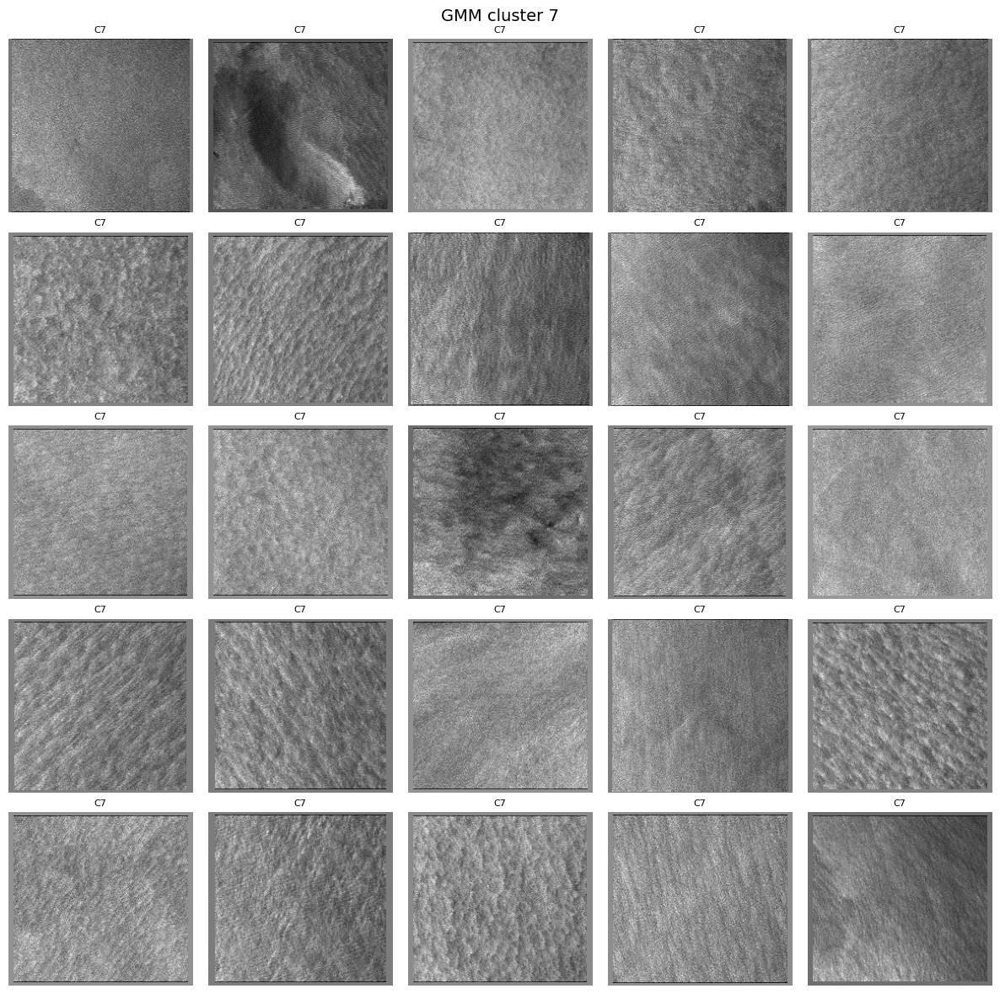

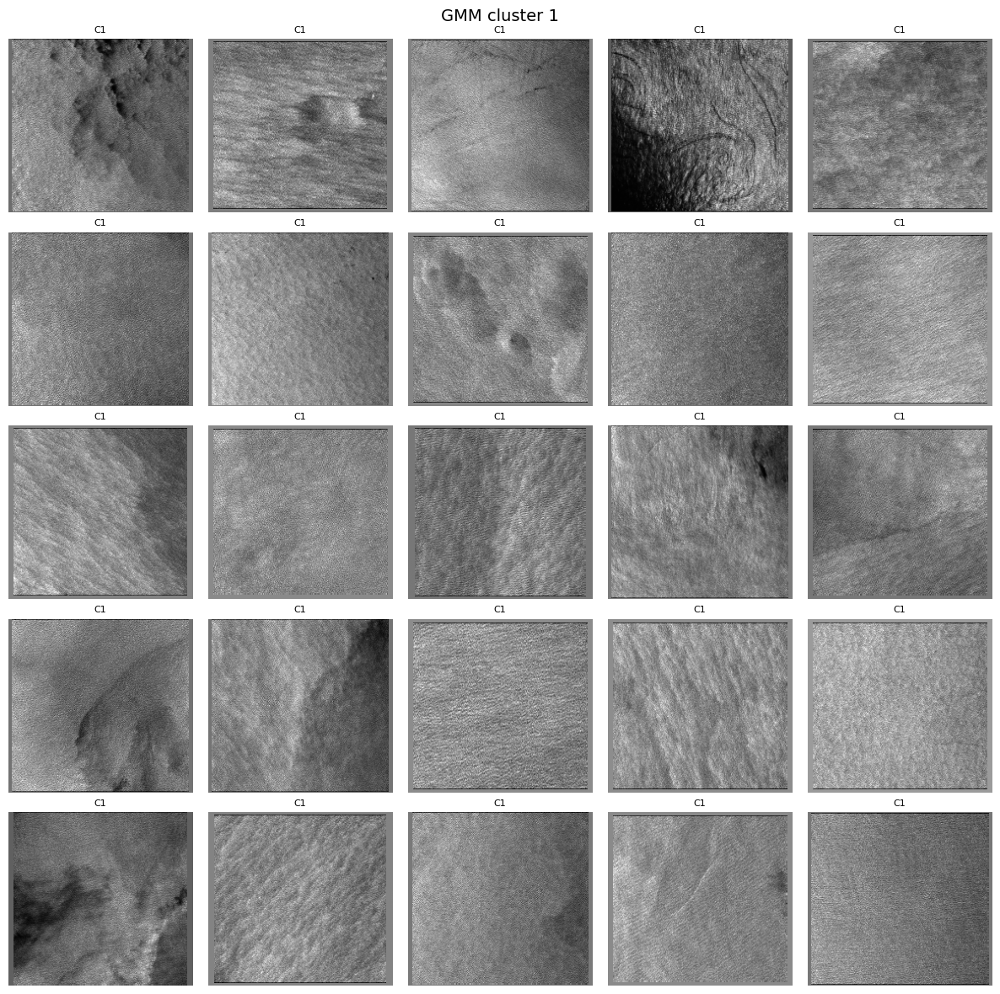

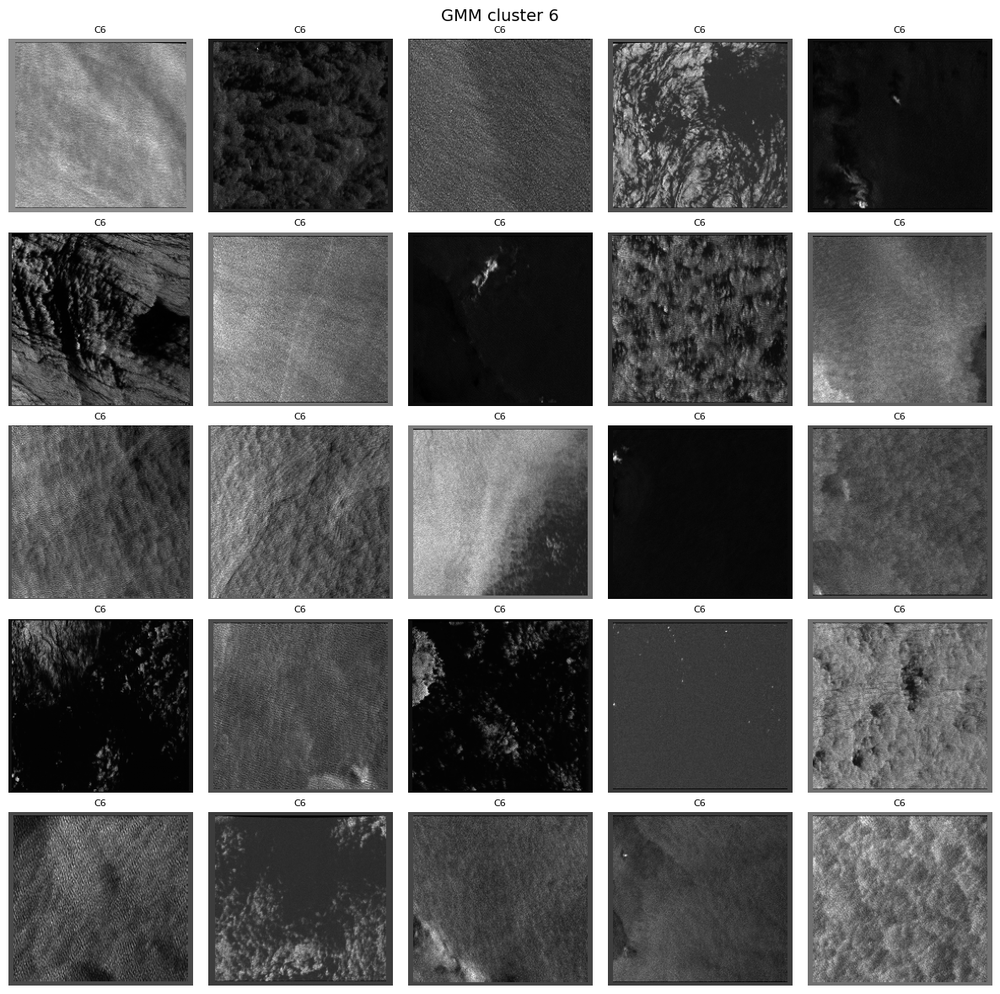

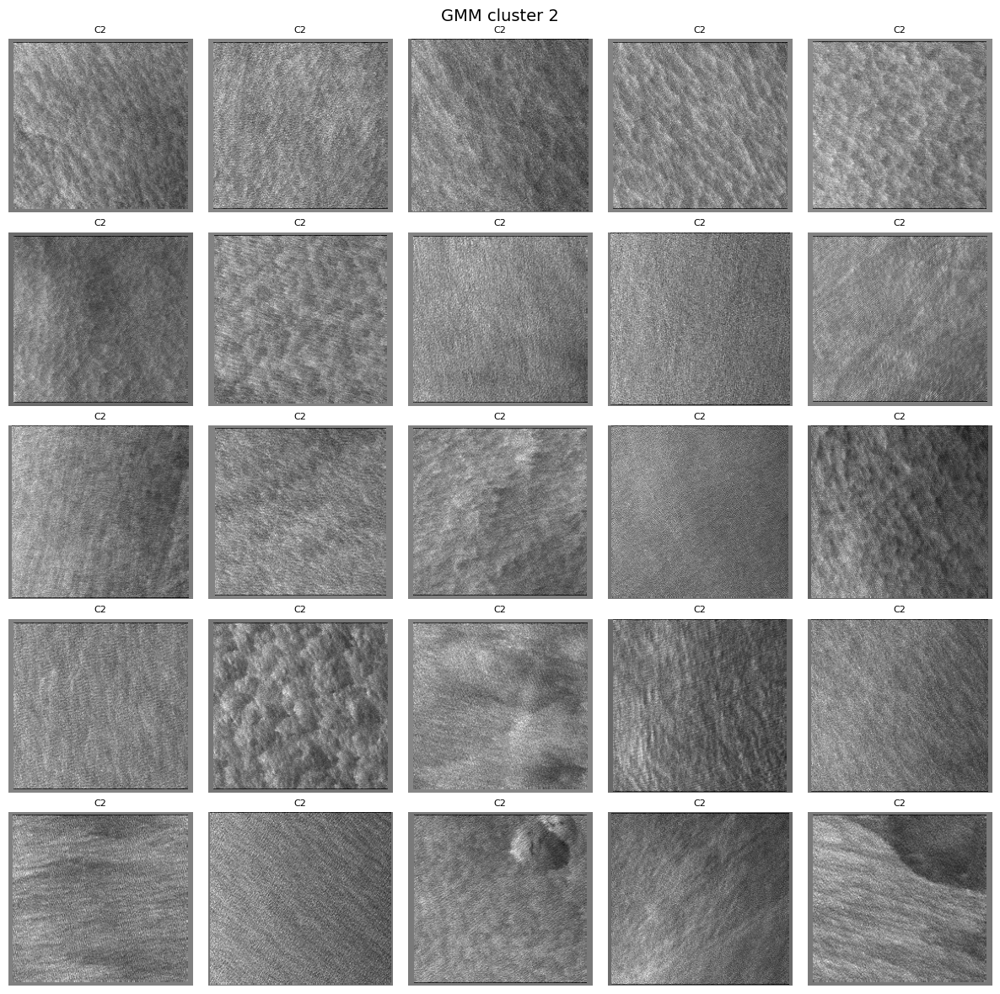

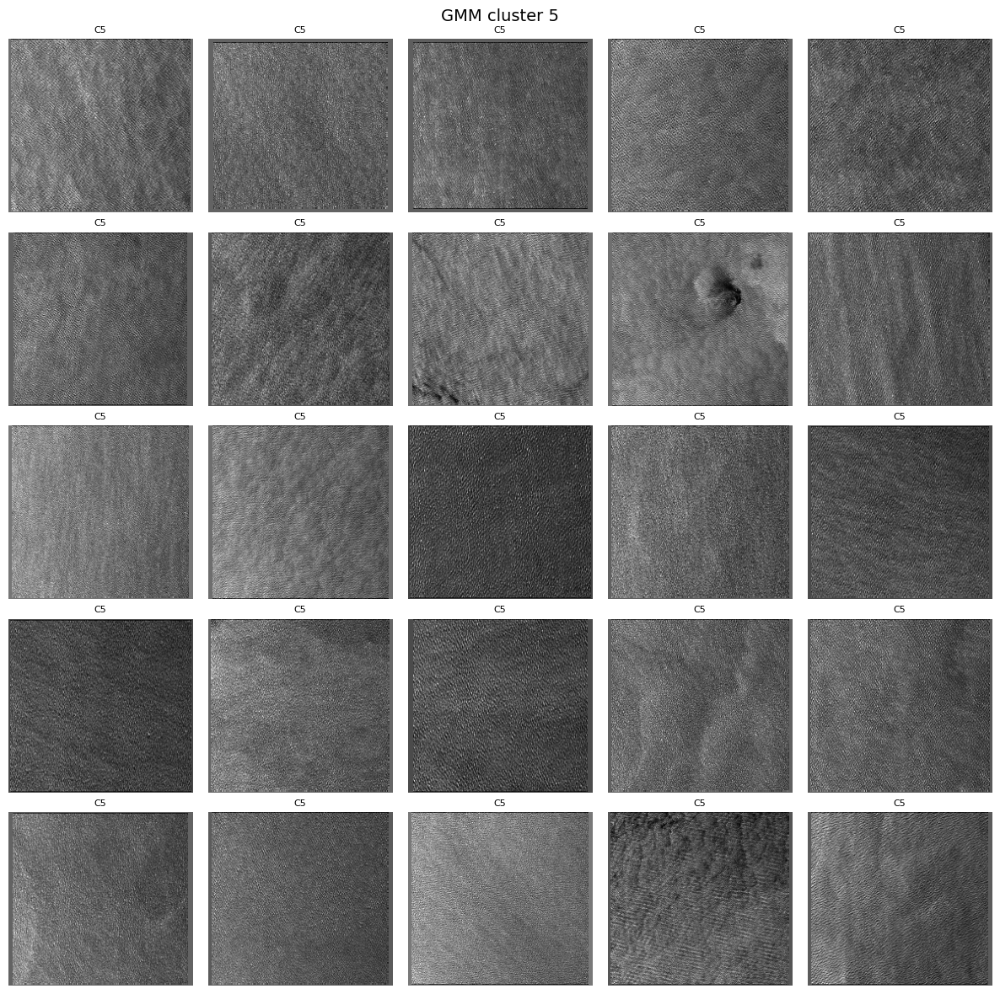

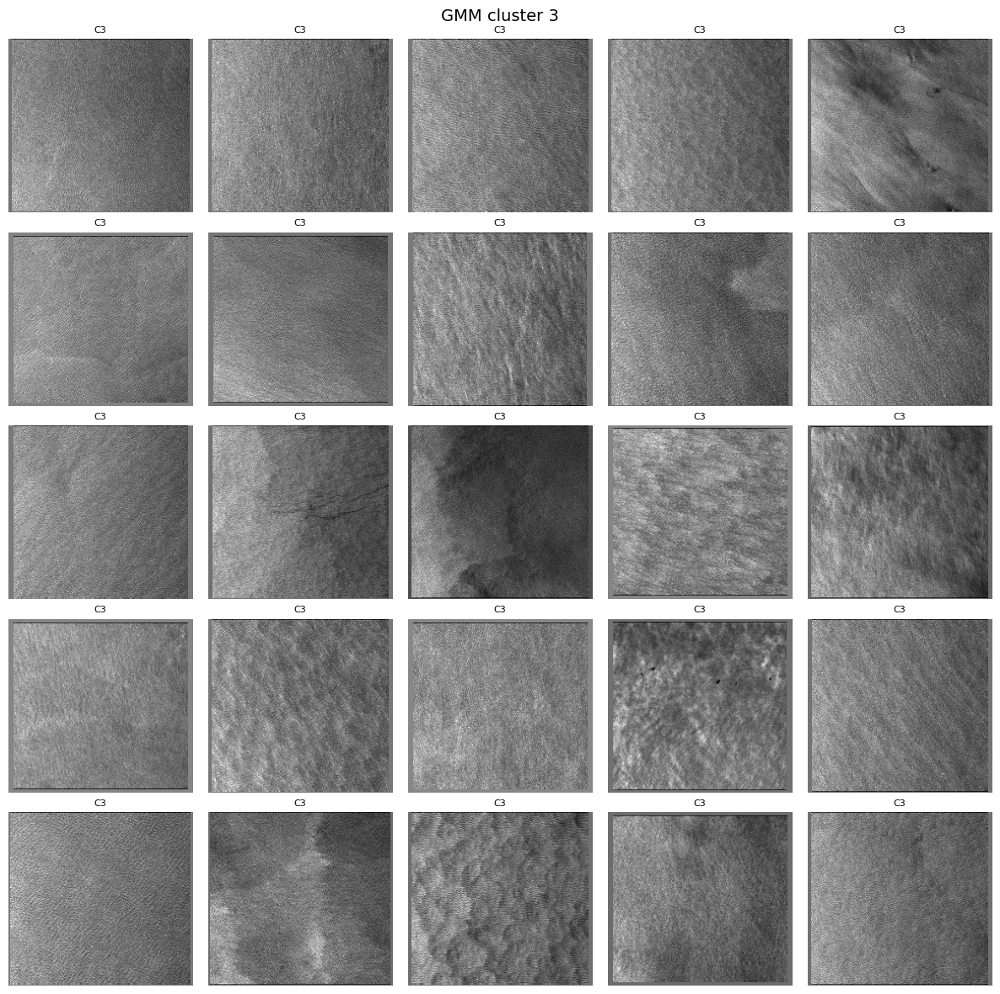

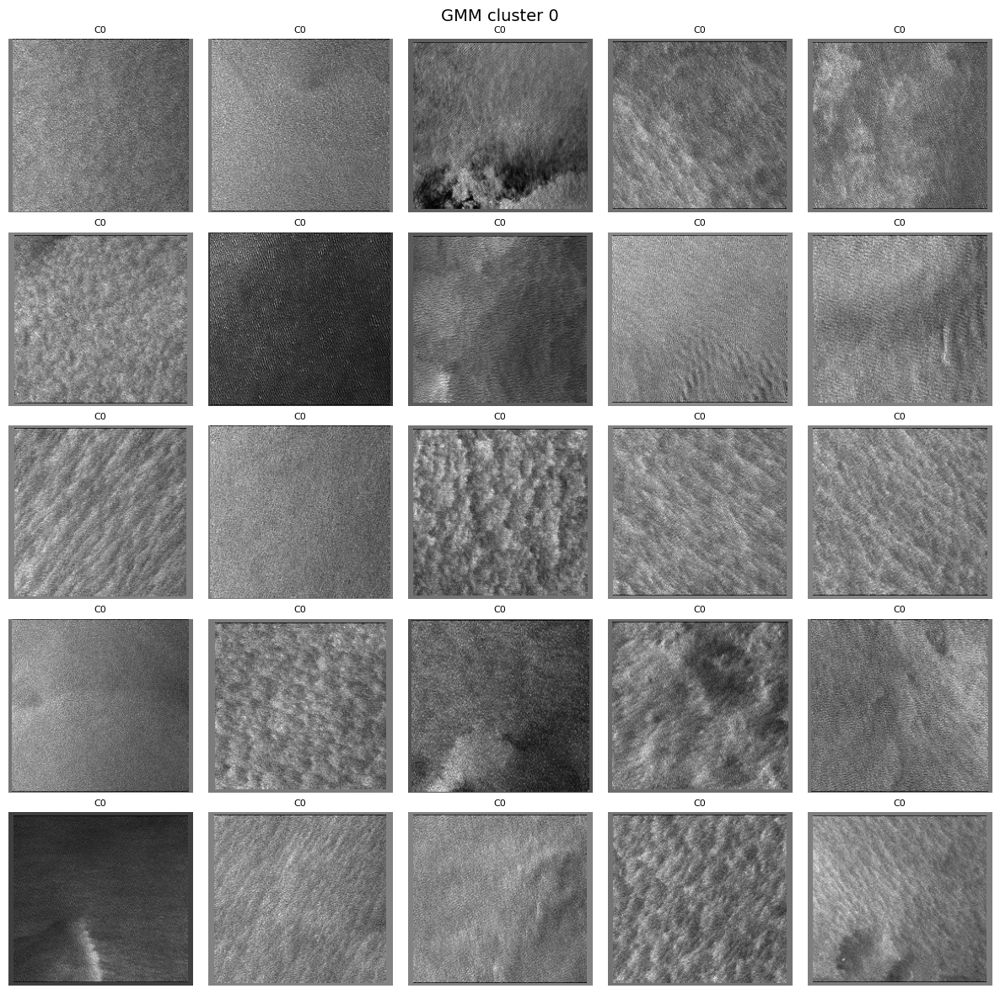

In [151]:
clustering_methods = [
    "kmeans",
    "hdbscan",
    "gmm"    
]

# store results for later visualization
all_cluster_ids = {}

for method in clustering_methods:
    print(f"Running {method} clustering...")
    
    if method == "kmeans":
        cluster_ids = cluster_features_cosine(reduced_features, num_clusters)
    elif method == "hdbscan":
        cluster_ids = cluster_hdbscan(reduced_features, min_cluster_size=100)
    elif method == "gmm":
        cluster_ids = cluster_gmm(reduced_features, num_clusters)
    else:
        raise ValueError(f"Unknown clustering method: {method}")
    
    all_cluster_ids[method] = cluster_ids
    
    # plot t-SNE
    visualize_clusters(
        reduced_features,
        cluster_ids,
        title=f"{method.upper()} SimCLR Feature Clustering"
    )
    
    # visualize sample images for each cluster
    print(f"Showing sample images for {method} clusters...")
    cluster_to_images = defaultdict(list)
    for img, cluster_id in zip(all_originals, cluster_ids):
        cluster_to_images[cluster_id].append(img)
    
    # visualization of 25 images per cluster in 5x5
    # visualization of 25 images per cluster in 5x5
    for cluster_id, images in cluster_to_images.items():
        plt.figure(figsize=(12, 12))
        for i, img in enumerate(images[:25]):
            plt.subplot(5, 5, i + 1)
            if isinstance(img, torch.Tensor):
                img = img.squeeze().numpy()
            plt.imshow(img, cmap="gray")
            plt.title(f"C{cluster_id}", fontsize=8)
            plt.axis("off")
        plt.suptitle(f"{method.upper()} cluster {cluster_id}", fontsize=14)
        plt.tight_layout()
        plt.show()
